In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib import rc
import unittest

%matplotlib inline
sns.set(style='whitegrid', palette='muted', font_scale=1.5)
rcParams['figure.figsize'] = 14, 8

RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)

def run_tests():
    unittest.main(argv=[''], verbosity=1, exit=False)

In [11]:
# Load the data
df_train = pd.read_csv('train.csv')
df_train.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


# Data Exploration 

In [6]:
df_train['SalePrice'].describe()

count      1460.000000
mean     180921.195890
std       79442.502883
min       34900.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
max      755000.000000
Name: SalePrice, dtype: float64

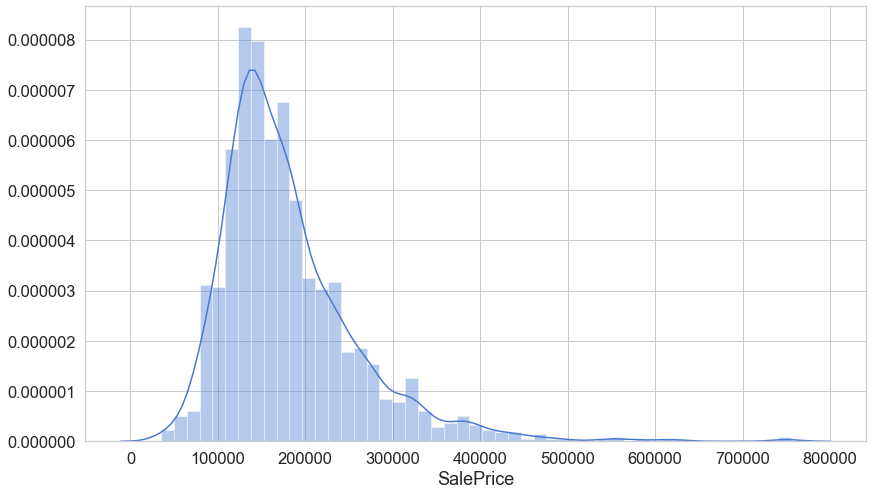

In [7]:
sns.distplot(df_train['SalePrice']);

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


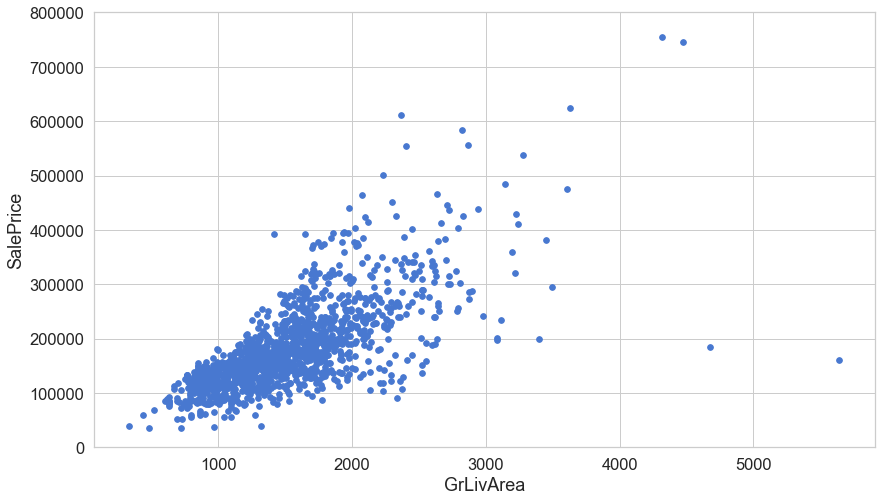

In [8]:
var = 'GrLivArea'
data = pd.concat([df_train['SalePrice'], df_train[var]], axis=1)
data.plot.scatter(x=var, y='SalePrice', ylim=(0,800000), s=32);

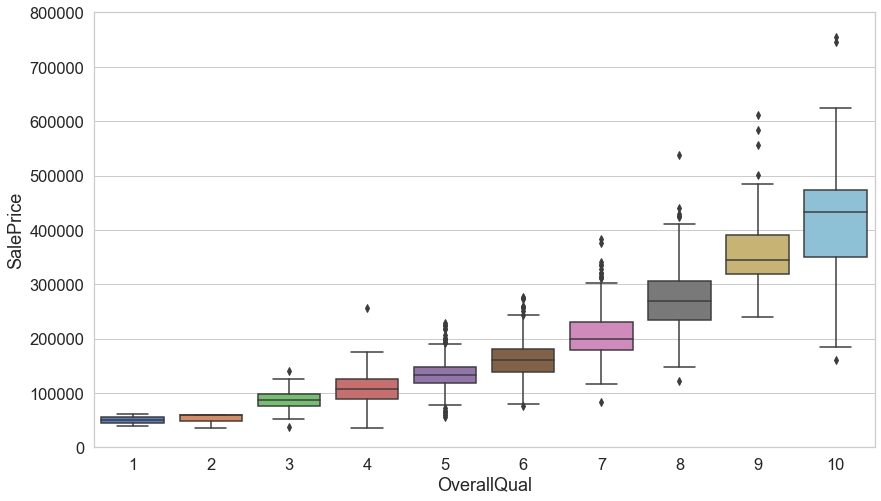

In [9]:
var = 'OverallQual'
data = pd.concat([df_train['SalePrice'], df_train[var]], axis=1)
f, ax = plt.subplots(figsize=(14, 8))
fig = sns.boxplot(x=var, y="SalePrice", data=data)
fig.axis(ymin=0, ymax=800000);

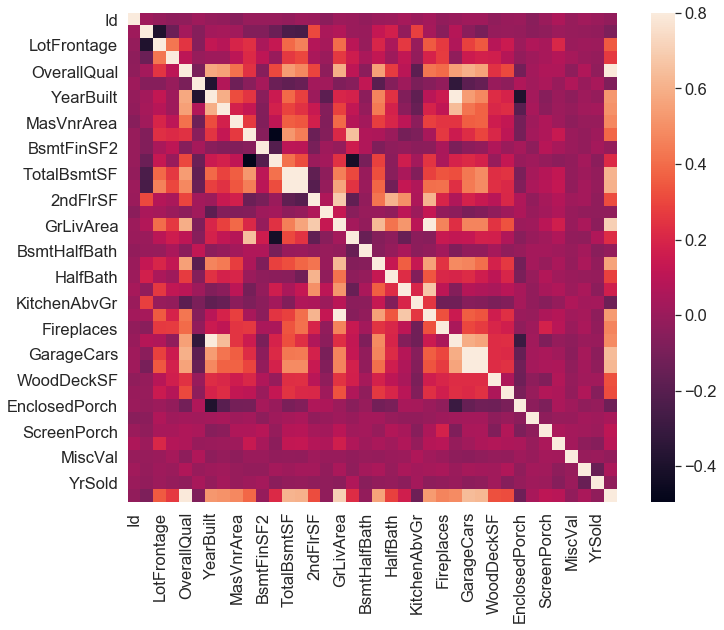

In [10]:
corrmat = df_train.corr()
f, ax = plt.subplots(figsize=(12, 9))
sns.heatmap(corrmat, vmax=.8, square=True);

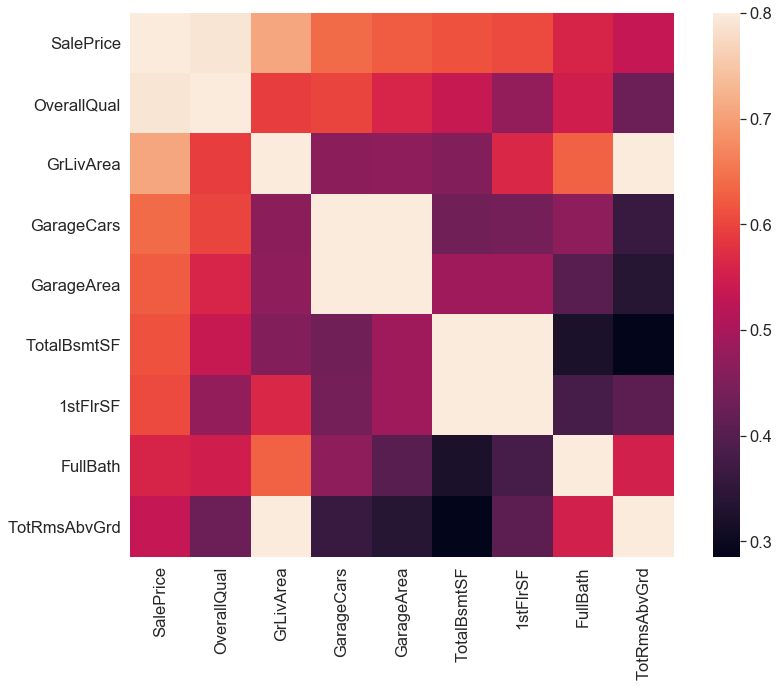

In [12]:
k = 9 #number of variables for heatmap
cols = corrmat.nlargest(k, 'SalePrice')['SalePrice'].index
f, ax = plt.subplots(figsize=(14, 10))
sns.heatmap(df_train[cols].corr(), vmax=.8, square=True);

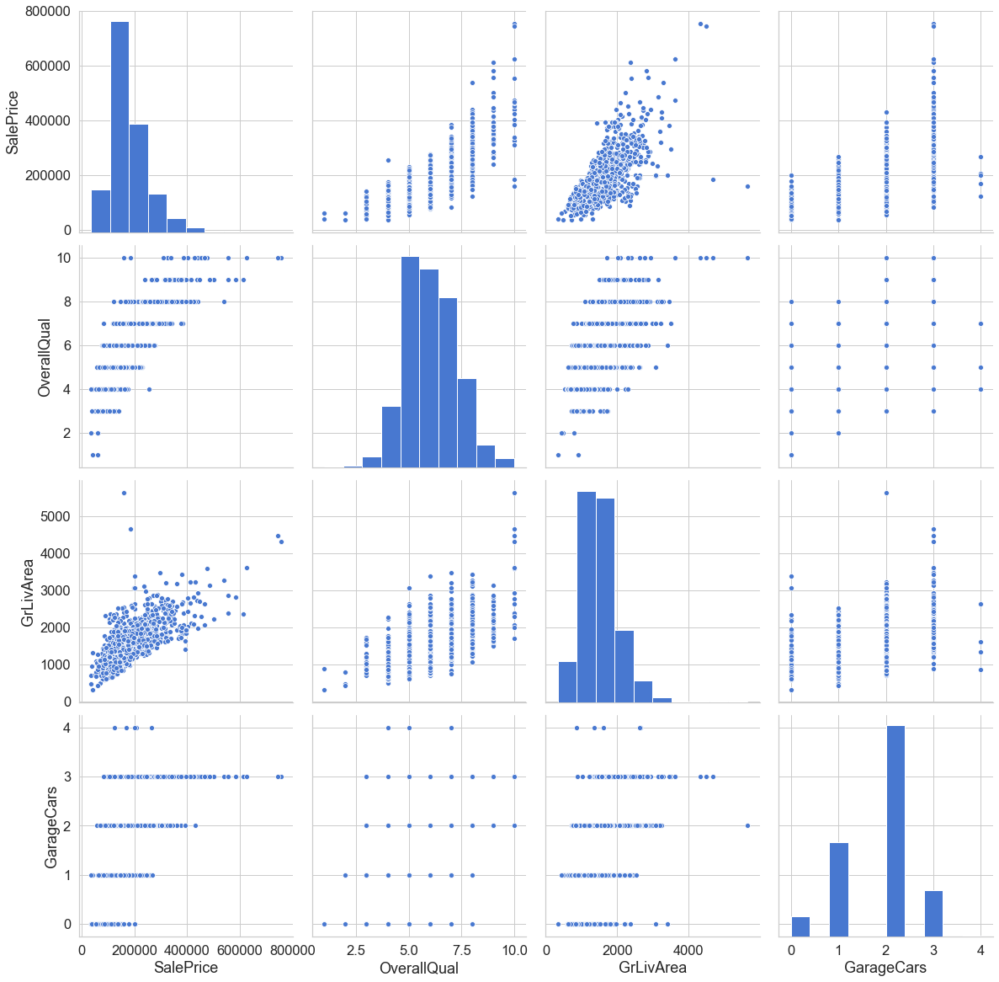

In [14]:
cols = ['SalePrice', 'OverallQual', 'GrLivArea', 'GarageCars']
sns.pairplot(df_train[cols], height = 4);

In [15]:
total = df_train.isnull().sum().sort_values(ascending=False)
percent = (df_train.isnull().sum()/df_train.isnull().count()).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_data.head(20)

,Total,Percent
PoolQC,1453,0.995205
MiscFeature,1406,0.963014
Alley,1369,0.937671
Fence,1179,0.807534
FireplaceQu,690,0.472603
LotFrontage,259,0.177397
GarageCond,81,0.055479
GarageType,81,0.055479
GarageYrBlt,81,0.055479
GarageFinish,81,0.055479


# Predicting Sales Price from Scratch using TDD

## Loss function

Given our Simple Linear Regression equation:

$$Y = bX + a$$

We can use the following cost function to find the coefficients:

### Mean Squared Error (MSE) Cost Function

The MSE is defined as:

$$MSE = J(W) =  \frac{1}{m} \sum_{i=1}^{m} (y^{(i)} - h_w(x^{(i)}))^2$$

where

$$h_w(x) = g(w^Tx)$$

The MSE measures how much the average model predictions vary from the correct values. The number is higher when the model is performing "bad" on the training set.

The first derivative of MSE is given by:

$$MSE' = J'(W) = \frac{2}{m} \sum_{i=1}^{m} (h_w(x^{(i)}) - y^{(i)})$$


### One Half Mean Squared Error (OHMSE)

We will apply a small modification to the MSE - multiply by $\frac{1}{2}$ so when we take the derivative, the `2`s cancel out:

$$ OHMSE = J(W) =  \frac{1}{2m} \sum_{i=1}^{m} (y^{(i)} - h_w(x^{(i)}))^2 $$

The first derivative of OHMSE is given by:

$$OHMSE' = J'(W) = \frac{1}{m} \sum_{i=1}^{m} (h_w(x^{(i)}) - y^{(i)})$$

In [16]:
class TestLoss(unittest.TestCase):
    
    def test_zero_h_zero_y(self):
        self.assertAlmostEqual(loss(h=np.array([0]), y=np.array([0])), 0)

    def test_one_h_zero_y(self):
        self.assertAlmostEqual(loss(h=np.array([1]), y=np.array([0])), 0.5)

    def test_two_h_zero_y(self):
        self.assertAlmostEqual(loss(h=np.array([2]), y=np.array([0])), 2)

    def test_zero_h_one_y(self):
        self.assertAlmostEqual(loss(h=np.array([0]), y=np.array([1])), 0.5)

    def test_zero_h_two_y(self):
        self.assertAlmostEqual(loss(h=np.array([0]), y=np.array([2])), 2)

In [20]:
def loss(h, y):
    sq_error = (y - h)**2
    m = len(y)
    
    return 1.0 / (2 * m) * sq_error.sum()

In [21]:
run_tests()

.....
----------------------------------------------------------------------
Ran 5 tests in 0.005s

OK


# 1) First Model  using only GrLivArea 

In [29]:
# Data preprocessing (standardization)

x = df_train.GrLivArea
y = df_train.SalePrice


x = (x - x.mean()) / x.std()
x = np.c_[np.ones(x.shape[0]), x] 

In [31]:
class TestLinearRegression(unittest.TestCase):

    def test_find_coefficients(self):
        clf = LinearRegression()
        clf.fit(x, y, n_iter=2000, lr=0.01)
        np.testing.assert_array_almost_equal(clf._W, np.array([180921.19555322,  56294.90199925]))

In [40]:
class LinearRegression:
    
    def predict(self, X):
        return np.dot(X, self._W)
    
    def _gradient_descent_step(self, X, targets, lr):
        predictions = self.predict(X)
        
        error = predictions - targets
        gradient = np.dot(X.T, error) / len(X)
        
        self._W -= lr * gradient
        
    def fit(self, X, y, n_iter=100000, lr=0.01):
        
        self._W = np.zeros(X.shape[1])
        
        self._cost_history = []
        self._w_history = [self._W]
        
        for i in range(n_iter):
            
            prediction = self.predict(X)
            cost = loss(prediction, y)
            self._cost_history.append(cost)
            
            self._gradient_descent_step(x, y, lr)
            self._w_history.append(self._W.copy())

        
        return self

In [41]:
run_tests()

......
----------------------------------------------------------------------
Ran 6 tests in 3.392s

OK


In [42]:
clf = LinearRegression()
clf.fit(x, y, n_iter=2000, lr=0.01)

In [43]:
clf._W

array([180921.19555322,  56294.90199925])

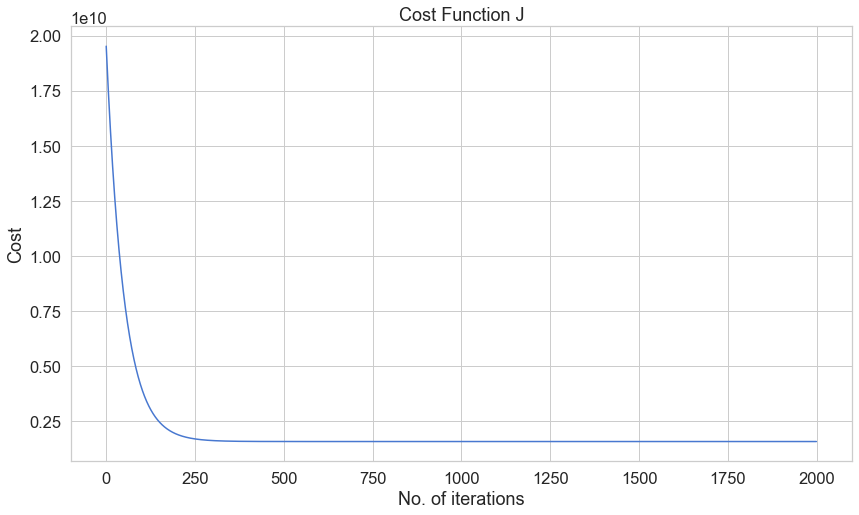

In [46]:
plt.title('Cost Function J')
plt.xlabel('No. of iterations')
plt.ylabel('Cost')
plt.plot(clf._cost_history)
plt.show()

In [47]:
#Animation

#Set the plot up,
fig = plt.figure()
ax = plt.axes()
plt.title('Sale Price vs Living Area')
plt.xlabel('Living Area in square feet (normalised)')
plt.ylabel('Sale Price ($)')
plt.scatter(x[:,1], y)
line, = ax.plot([], [], lw=2, color='red')
annotation = ax.text(-1, 700000, '')
annotation.set_animated(True)
plt.close()

#Generate the animation data,
def init():
    line.set_data([], [])
    annotation.set_text('')
    return line, annotation

# animation function.  This is called sequentially
def animate(i):
    x = np.linspace(-5, 20, 1000)
    y = clf._w_history[i][1]*x + clf._w_history[i][0]
    line.set_data(x, y)
    annotation.set_text('Cost = %.2f e10' % (clf._cost_history[i]/10000000000))
    return line, annotation

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=300, interval=10, blit=True)

rc('animation', html='jshtml')

anim

Animation size has reached 20995842 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


# 2) Multivariable Linear Regression

In [48]:
x = df_train[['OverallQual', 'GrLivArea', 'GarageCars']]

x = (x - x.mean()) / x.std()
x = np.c_[np.ones(x.shape[0]), x] 

clf = LinearRegression()
clf.fit(x, y, n_iter=2000, lr=0.01)

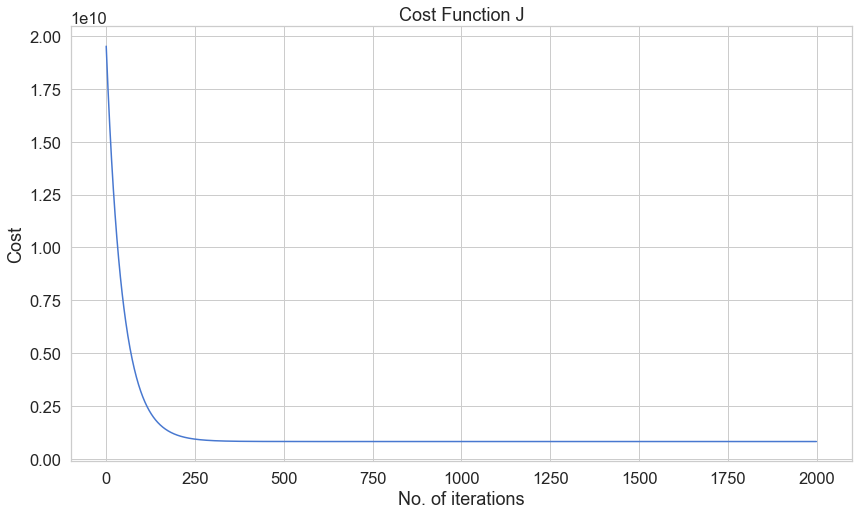

In [49]:
plt.title('Cost Function J')
plt.xlabel('No. of iterations')
plt.ylabel('Cost')
plt.plot(clf._cost_history)
plt.show()

In [50]:
clf._cost_history

[19519633853.882877,
 19098037302.061356,
 18686911847.40952,
 18285962169.236576,
 17894902451.731163,
 17513456043.462547,
 17141355129.971428,
 16778340418.92661,
 16424160837.34503,
 16078573240.39317,
 15741342131.307758,
 15412239391.992172,
 15091044023.863445,
 14777541898.541807,
 14471525517.991482,
 14172793783.73737,
 13881151774.797495,
 13596410533.985771,
 13318386862.253708,
 13046903120.753162,
 12781787040.315018,
 12522871538.051321,
 12269994540.799984,
 12022998815.142765,
 11781731803.738077,
 11546045467.720608,
 11315796134.929815,
 11090844353.739017,
 10871054752.265923,
 10656295902.754427,
 10446440190.925875,
 10241363690.106188,
 10040946039.943052,
 9845070329.534836,
 9653622984.80009,
 9466493659.923347,
 9283575132.719576,
 9104763203.76597,
 8929956599.155746,
 8759056876.734594,
 8591968335.68584,
 8428597929.335921,
 8268855181.056694,
 8112652103.146252,
 7959903118.574478,
 7810524985.484185,
 7664436724.343008,
 7521559547.645404,
 7381816792.068